# Temperature Forecast Project using ML

## Project Description

This data is for the purpose of bias correction of next-day maximum and minimum air temperatures forecast of the LDAPS model operated by the Korea Meteorological Administration over Seoul, South Korea. This data consists of summer data from 2013 to 2017. The input data is largely composed of the LDAPS model's next-day forecast data, in-situ maximum and minimum temperatures of present-day, and geographic auxiliary variables. There are two outputs (i.e. next-day maximum and minimum air temperatures) in this data. Hindcast validation was conducted for the period from 2015 to 2017.

## Attribute Information:

### For more information, read [Cho et al, 2020]

1. station - used weather station number: 1 to 25
    
2. Date - Present day: yyyy-mm-dd ('2013-06-30' to '2017-08-30')
    
3. Present_Tmax - Maximum air temperature between 0 and 21 h on the present day (Â°C): 20 to 37.6
    
4. Present_Tmin - Minimum air temperature between 0 and 21 h on the present day (Â°C): 11.3 to 29.9
    
5. LDAPS_RHmin - LDAPS model forecast of next-day minimum relative humidity (%): 19.8 to 98.5
    
6. LDAPS_RHmax - LDAPS model forecast of next-day maximum relative humidity (%): 58.9 to 100
    
7. LDAPS_Tmax_lapse - LDAPS model forecast of next-day maximum air temperature applied lapse rate (Â°C): 17.6 to 38.5
    
8. LDAPS_Tmin_lapse - LDAPS model forecast of next-day minimum air temperature applied lapse rate (Â°C): 14.3 to 29.6
    
9. LDAPS_WS - LDAPS model forecast of next-day average wind speed (m/s): 2.9 to 21.9
    
10. LDAPS_LH - LDAPS model forecast of next-day average latent heat flux (W/m2): -13.6 to 213.4
    
11. LDAPS_CC1 - LDAPS model forecast of next-day 1st 6-hour split average cloud cover (0-5 h) (%): 0 to 0.97
    
12. LDAPS_CC2 - LDAPS model forecast of next-day 2nd 6-hour split average cloud cover (6-11 h) (%): 0 to 0.97
    
13. LDAPS_CC3 - LDAPS model forecast of next-day 3rd 6-hour split average cloud cover (12-17 h) (%): 0 to 0.98

14. LDAPS_CC4 - LDAPS model forecast of next-day 4th 6-hour split average cloud cover (18-23 h) (%): 0 to 0.97

15. LDAPS_PPT1 - LDAPS model forecast of next-day 1st 6-hour split average precipitation (0-5 h) (%): 0 to 23.7

16. LDAPS_PPT2 - LDAPS model forecast of next-day 2nd 6-hour split average precipitation (6-11 h) (%): 0 to 21.6

17. LDAPS_PPT3 - LDAPS model forecast of next-day 3rd 6-hour split average precipitation (12-17 h) (%): 0 to 15.8

18. LDAPS_PPT4 - LDAPS model forecast of next-day 4th 6-hour split average precipitation (18-23 h) (%): 0 to 16.7

19. lat - Latitude (Â°): 37.456 to 37.645

20. lon - Longitude (Â°): 126.826 to 127.135

21. DEM - Elevation (m): 12.4 to 212.3

22. Slope - Slope (Â°): 0.1 to 5.2

23. Solar radiation - Daily incoming solar radiation (wh/m2): 4329.5 to 5992.9

24. Next_Tmax - The next-day maximum air temperature (Â°C): 17.4 to 38.9

25. Next_Tmin - The next-day minimum air temperature (Â°C): 11.3 to 29.8T



## Task

You have to build separate models that can predict the minimum temperature for the next day and the maximum temperature for the next day based on the details provided in the dataset.

## Dataset Link

https://github.com/dsrscientist/Dataset2/blob/main/temperature.csv

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

# Importing Data

In [2]:
df=pd.read_csv('temperature.csv')
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3


# EDA

In [3]:
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5


In [4]:
df.tail()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3
7751,NaN,NaN,37.6,29.9,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,...,21.621661,15.841235,16.655469,37.6450,127.135,212.3350,5.178230,5992.895996,38.9,29.8


In [5]:
#Checking the dimentions of the dataset

df.shape

(7752, 25)

The dataset has 7752 rows and 25 columns.

In [6]:
#Checking the columns of the dataset

df.columns.to_list()

['station',
 'Date',
 'Present_Tmax',
 'Present_Tmin',
 'LDAPS_RHmin',
 'LDAPS_RHmax',
 'LDAPS_Tmax_lapse',
 'LDAPS_Tmin_lapse',
 'LDAPS_WS',
 'LDAPS_LH',
 'LDAPS_CC1',
 'LDAPS_CC2',
 'LDAPS_CC3',
 'LDAPS_CC4',
 'LDAPS_PPT1',
 'LDAPS_PPT2',
 'LDAPS_PPT3',
 'LDAPS_PPT4',
 'lat',
 'lon',
 'DEM',
 'Slope',
 'Solar radiation',
 'Next_Tmax',
 'Next_Tmin']

In [7]:
# Checking the types of columns

df.dtypes

station             float64
Date                 object
Present_Tmax        float64
Present_Tmin        float64
LDAPS_RHmin         float64
LDAPS_RHmax         float64
LDAPS_Tmax_lapse    float64
LDAPS_Tmin_lapse    float64
LDAPS_WS            float64
LDAPS_LH            float64
LDAPS_CC1           float64
LDAPS_CC2           float64
LDAPS_CC3           float64
LDAPS_CC4           float64
LDAPS_PPT1          float64
LDAPS_PPT2          float64
LDAPS_PPT3          float64
LDAPS_PPT4          float64
lat                 float64
lon                 float64
DEM                 float64
Slope               float64
Solar radiation     float64
Next_Tmax           float64
Next_Tmin           float64
dtype: object

There are two different data types in the dataset - float64 and object. Numerical and categorical data - just the Date column.

In [8]:
# Checking the null values

df.isnull().sum()

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

As we can see there is missing data in the dataset.

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7750 non-null   float64
 1   Date              7750 non-null   object 
 2   Present_Tmax      7682 non-null   float64
 3   Present_Tmin      7682 non-null   float64
 4   LDAPS_RHmin       7677 non-null   float64
 5   LDAPS_RHmax       7677 non-null   float64
 6   LDAPS_Tmax_lapse  7677 non-null   float64
 7   LDAPS_Tmin_lapse  7677 non-null   float64
 8   LDAPS_WS          7677 non-null   float64
 9   LDAPS_LH          7677 non-null   float64
 10  LDAPS_CC1         7677 non-null   float64
 11  LDAPS_CC2         7677 non-null   float64
 12  LDAPS_CC3         7677 non-null   float64
 13  LDAPS_CC4         7677 non-null   float64
 14  LDAPS_PPT1        7677 non-null   float64
 15  LDAPS_PPT2        7677 non-null   float64
 16  LDAPS_PPT3        7677 non-null   float64


<Axes: >

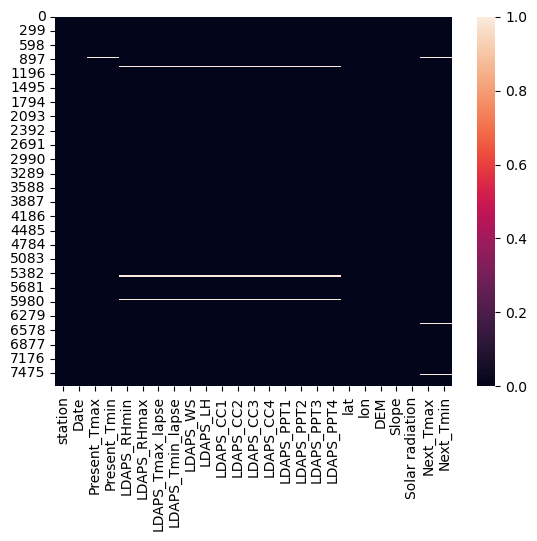

In [10]:
# Using heatmap to visualize the null values.

sns.heatmap(df.isnull())

As the dataset doesn't have a lot of missing data we can just drop the  null values.

In [11]:
# Dropping NuLL Values

df.dropna(inplace=True)

In [12]:
# Checking for null values after dropping

df.isnull().sum()

station             0
Date                0
Present_Tmax        0
Present_Tmin        0
LDAPS_RHmin         0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_Tmin_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT2          0
LDAPS_PPT3          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
Next_Tmin           0
dtype: int64

In [13]:
df.shape

(7588, 25)

164 rows have been dropped.

In [14]:
# Calculating Data Loss after dropping the null values.

before= 7752
after= 7588

print("Data Loss Percentage:", ((before - after)/before)*100) 

Data Loss Percentage: 2.1155830753353975


In [15]:
# Checking for diblicate values

df.duplicated().sum()

0

There is no dublicate values.

In [16]:
#Checking for unique values of each column.

for i in df.columns:
    print(df[i].unique())
    print("\n")

[ 1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 11. 12. 13. 14. 15. 16. 17. 18.
 19. 20. 21. 22. 23. 24. 25.]


['30-06-2013' '01-07-2013' '02-07-2013' '03-07-2013' '04-07-2013'
 '05-07-2013' '06-07-2013' '07-07-2013' '08-07-2013' '09-07-2013'
 '10-07-2013' '11-07-2013' '12-07-2013' '13-07-2013' '14-07-2013'
 '15-07-2013' '16-07-2013' '17-07-2013' '18-07-2013' '19-07-2013'
 '20-07-2013' '21-07-2013' '22-07-2013' '23-07-2013' '24-07-2013'
 '25-07-2013' '26-07-2013' '27-07-2013' '28-07-2013' '29-07-2013'
 '30-07-2013' '31-07-2013' '01-08-2013' '02-08-2013' '03-08-2013'
 '04-08-2013' '05-08-2013' '06-08-2013' '07-08-2013' '08-08-2013'
 '09-08-2013' '11-08-2013' '12-08-2013' '13-08-2013' '14-08-2013'
 '15-08-2013' '16-08-2013' '17-08-2013' '18-08-2013' '19-08-2013'
 '20-08-2013' '21-08-2013' '22-08-2013' '23-08-2013' '24-08-2013'
 '25-08-2013' '26-08-2013' '27-08-2013' '28-08-2013' '29-08-2013'
 '30-08-2013' '30-06-2014' '01-07-2014' '02-07-2014' '03-07-2014'
 '04-07-2014' '05-07-2014' '06-07-201

In [17]:
#Checking the number of unique values in each column

df.nunique().to_frame("Number of unique values")

,Number of unique values
station,25
Date,307
Present_Tmax,167
Present_Tmin,155
LDAPS_RHmin,7585
LDAPS_RHmax,7577
LDAPS_Tmax_lapse,7588
LDAPS_Tmin_lapse,7588
LDAPS_WS,7588
LDAPS_LH,7588


In [18]:
#Checking the value counts of each column.

for i in df.columns:
    print(df[i].value_counts())
    print("\n")

25.0    307
10.0    307
23.0    307
18.0    307
17.0    307
2.0     307
3.0     306
4.0     306
13.0    305
16.0    304
20.0    304
21.0    304
14.0    303
1.0     303
9.0     302
12.0    302
15.0    302
19.0    302
22.0    302
24.0    302
11.0    301
7.0     301
6.0     301
8.0     300
5.0     296
Name: station, dtype: int64


30-06-2013    25
23-07-2016    25
22-08-2015    25
23-08-2015    25
24-08-2015    25
              ..
13-08-2015    22
24-07-2015    22
06-07-2017    22
23-08-2017    22
30-06-2017    16
Name: Date, Length: 307, dtype: int64


31.4    112
29.4    108
29.1    106
29.2    105
30.6    105
       ... 
21.2      1
20.1      1
36.4      1
20.3      1
20.0      1
Name: Present_Tmax, Length: 167, dtype: int64


24.0    160
23.8    153
23.5    143
23.1    143
23.3    140
       ... 
14.3      1
29.9      1
29.7      1
29.1      1
15.0      1
Name: Present_Tmin, Length: 155, dtype: int64


77.030350    2
51.810596    2
71.658089    2
58.255688    1
46.582764    1
        

## Description of the dataset

In [19]:
# for numerical data

df.describe()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
count,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,...,7588.000000,7588.000000,7588.000000,7588.000000,7588.00000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000
mean,13.014101,29.748366,23.195809,56.724969,88.360823,29.620128,23.511786,7.094097,62.492606,0.368510,...,0.480738,0.275007,0.265373,37.544792,126.99142,61.918136,1.259755,5343.724208,30.241526,22.910820
std,7.217858,2.967401,2.400880,14.626559,7.199456,2.943496,2.342579,2.177034,33.686158,0.262260,...,1.743327,1.146087,1.179661,0.050428,0.07922,54.323529,1.372748,429.782561,3.111807,2.482256
min,1.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,...,0.000000,0.000000,0.000000,37.456200,126.82600,12.370000,0.098500,4329.520508,17.400000,11.300000
25%,7.000000,27.800000,21.600000,45.960243,84.203724,27.673756,22.086820,5.675358,37.206201,0.146546,...,0.000000,0.000000,0.000000,37.510200,126.93700,28.700000,0.271300,5001.485717,28.200000,21.300000
50%,13.000000,29.900000,23.400000,55.023199,89.784122,29.709537,23.758249,6.547838,56.898324,0.315706,...,0.000000,0.000000,0.000000,37.550700,126.99500,45.716000,0.618000,5441.987305,30.400000,23.100000
75%,19.000000,32.000000,24.800000,67.115099,93.742725,31.711109,25.155660,8.028960,84.235666,0.574174,...,0.017735,0.007855,0.000017,37.577600,127.04200,59.832400,1.767800,5729.485840,32.600000,24.600000
max,25.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,...,21.621661,15.841235,16.655469,37.645000,127.13500,212.335000,5.178200,5992.895996,38.900000,29.800000


In [20]:
# for object data

df.describe(include="object")

,Date
count,7588
unique,307
top,30-06-2013
freq,25


# Data Visualization

## Univariate Analysis

24.0    160
23.8    153
23.5    143
23.1    143
23.3    140
       ... 
14.3      1
29.9      1
29.7      1
29.1      1
15.0      1
Name: Present_Tmin, Length: 155, dtype: int64


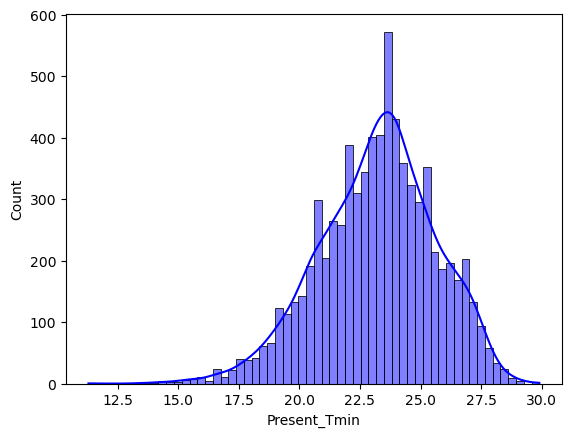

In [21]:
# Visualization the Present_Tmin

sns.histplot(df['Present_Tmin'],kde=True,color='b')
print(df['Present_Tmin'].value_counts())

The majority of the recorded Minimun tempreture is between 21 and 26 degrees.

31.4    112
29.4    108
29.1    106
29.2    105
30.6    105
       ... 
21.2      1
20.1      1
36.4      1
20.3      1
20.0      1
Name: Present_Tmax, Length: 167, dtype: int64


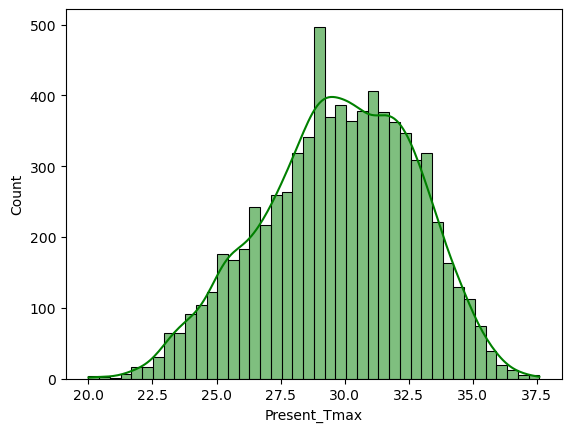

In [22]:
# Visualization the Present_Tmax

sns.histplot(df['Present_Tmax'],kde=True,color='g')
print(df['Present_Tmax'].value_counts())

The majority of the recorded Maximum Tempreture is between 27 and 33 degrees.

23.5    157
24.0    152
23.4    150
23.2    148
23.8    146
       ... 
29.8      1
28.5      1
29.1      1
29.4      1
12.9      1
Name: Next_Tmin, Length: 157, dtype: int64


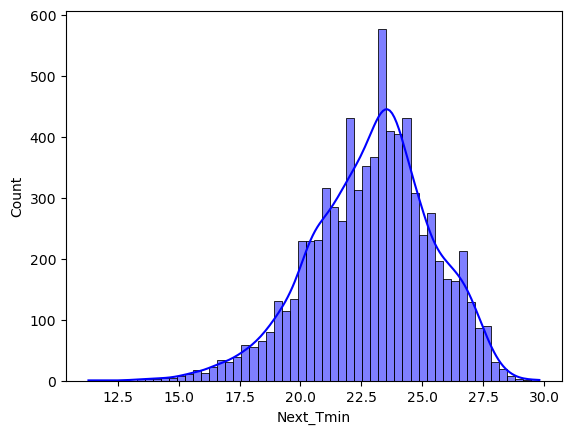

In [23]:
# Visualization the Next_Tmin

sns.histplot(df['Next_Tmin'],kde=True,color='b')
print(df['Next_Tmin'].value_counts())

The majority of the recorded Next day Minimun tempreture is between 22 and 26 degrees.

29.3    113
33.0    104
31.3    100
29.6     98
31.2     97
       ... 
37.5      1
38.7      1
37.4      1
20.9      1
17.4      1
Name: Next_Tmax, Length: 181, dtype: int64


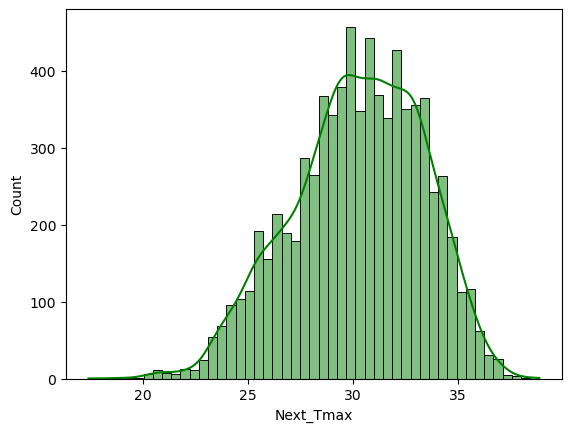

In [24]:
# Visualization the Next_Tmax

sns.histplot(df['Next_Tmax'],kde=True,color='g')
print(df['Next_Tmax'].value_counts())

The majority of the recorded Next day Maximum Tempreture is between 27 and 33 degrees.

## Bivariate Analysis

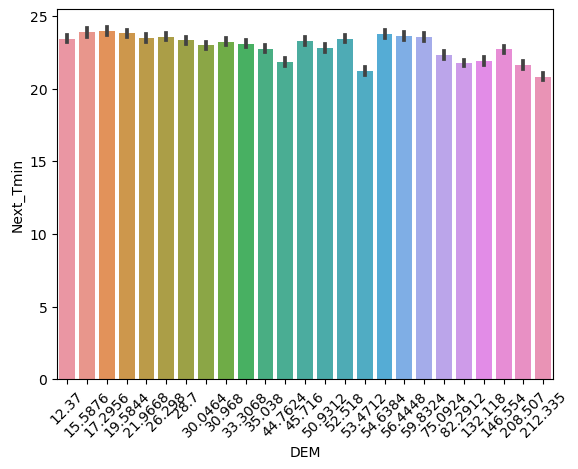

In [25]:
# Visualizing DEm vs Next_tmin

sns.barplot(x='DEM', y='Next_Tmin', data=df)
plt.xticks(rotation=45)
plt.show()

DEM is the elevation in meters. With increasing the elevation, the Next Day Min Tempreture reduces.

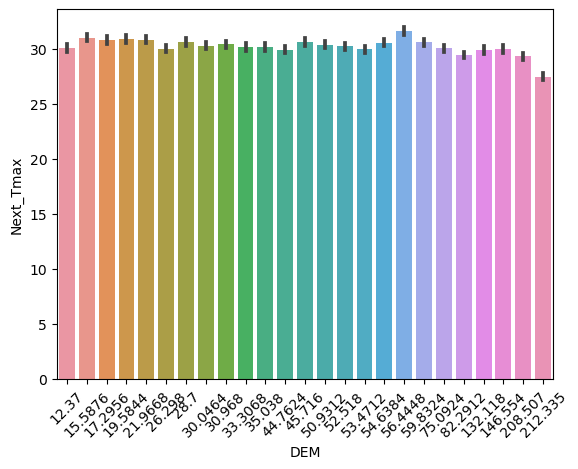

In [26]:
# Visualizing DEm vs Next_Tmin

sns.barplot(x='DEM', y='Next_Tmax', data=df)
plt.xticks(rotation=45)
plt.show()

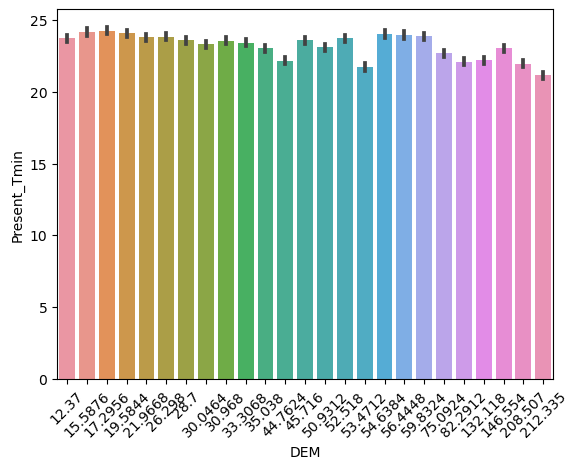

In [27]:
# Visualizing DEm vs Present_Tmin

sns.barplot(x='DEM', y='Present_Tmin', data=df)
plt.xticks(rotation=45)
plt.show()

 With increasing the elevation, the Precent Min Tempreture reduces.

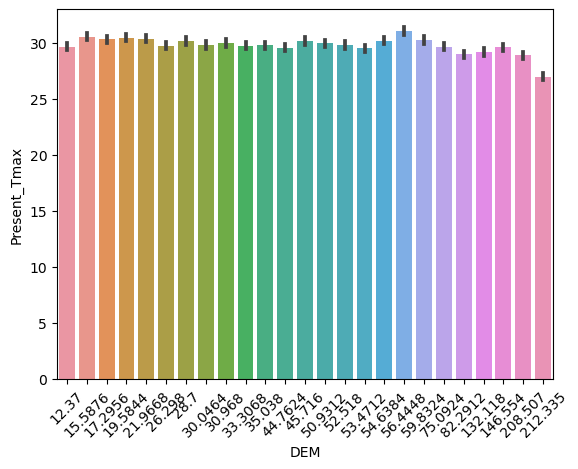

In [28]:
# Visualizing DEm vs Present_Tmax

sns.barplot(x='DEM', y='Present_Tmax', data=df)
plt.xticks(rotation=45)
plt.show()

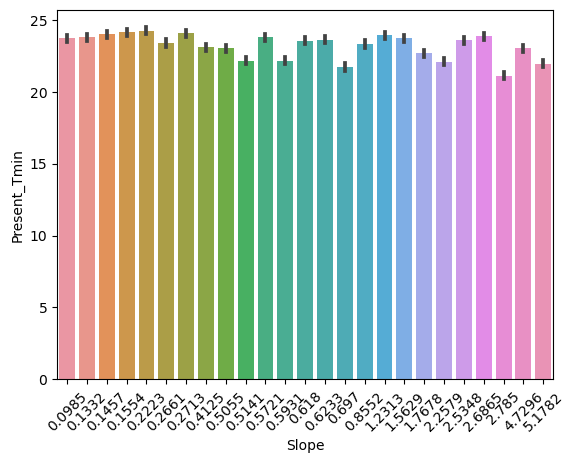

In [29]:
# Visualizing Slope vs Present_Tmin

sns.barplot(x='Slope', y='Present_Tmin', data=df)
plt.xticks(rotation=45)
plt.show()

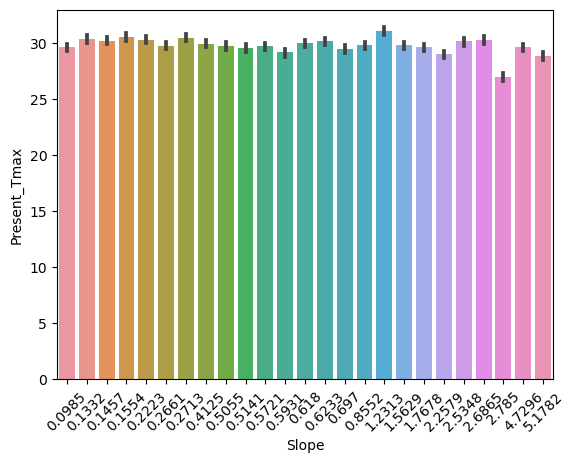

In [30]:
# Visualizing Slope vs Present_Tmax

sns.barplot(x='Slope', y='Present_Tmax', data=df)
plt.xticks(rotation=45)
plt.show()

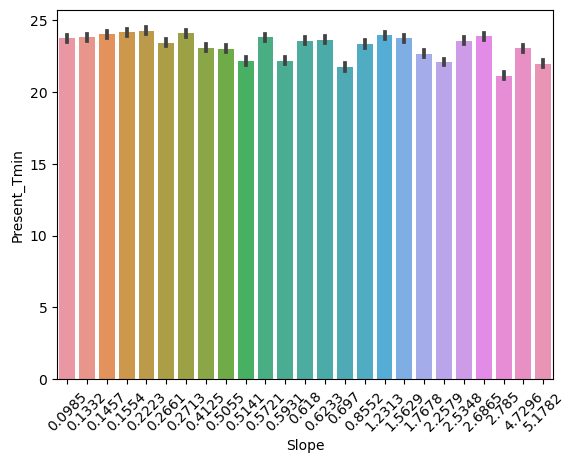

In [31]:
# Visualizing Slope vs Present_Tmin

sns.barplot(x='Slope', y='Present_Tmin', data=df)
plt.xticks(rotation=45)
plt.show()

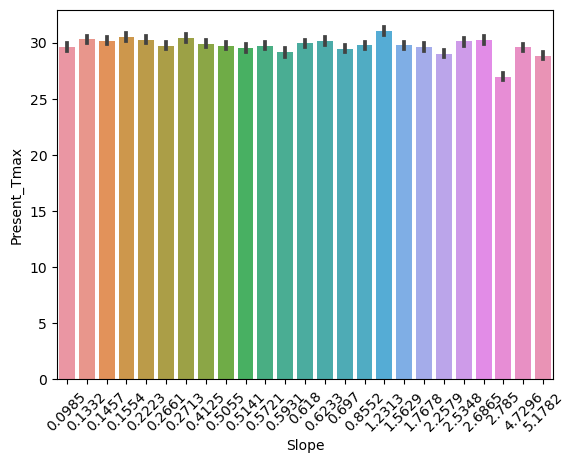

In [32]:
# Visualizing Slope vs Present_Tmax

sns.barplot(x='Slope', y='Present_Tmax', data=df)
plt.xticks(rotation=45)
plt.show()

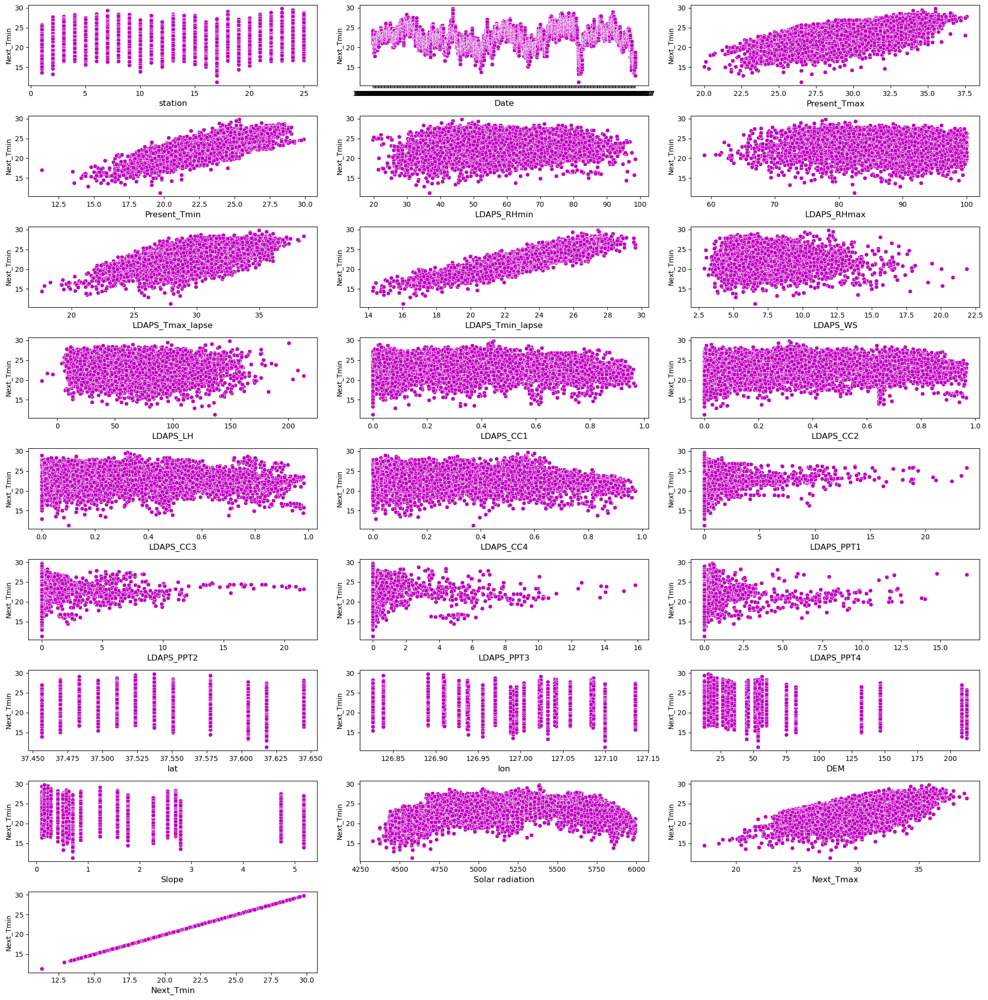

In [33]:
#Visiualizing all columns vs Next_Tmin 

plt.figure(figsize=(20,22), facecolor='white')
plotnumber=1
for col in df:
    if plotnumber<=30:
        ax=plt.subplot(10,3,plotnumber) 
        sns.scatterplot(x=df[col],y=df['Next_Tmin'], color='m')
        plt.xlabel(col,fontsize=12)
    plotnumber+=1
plt.tight_layout()

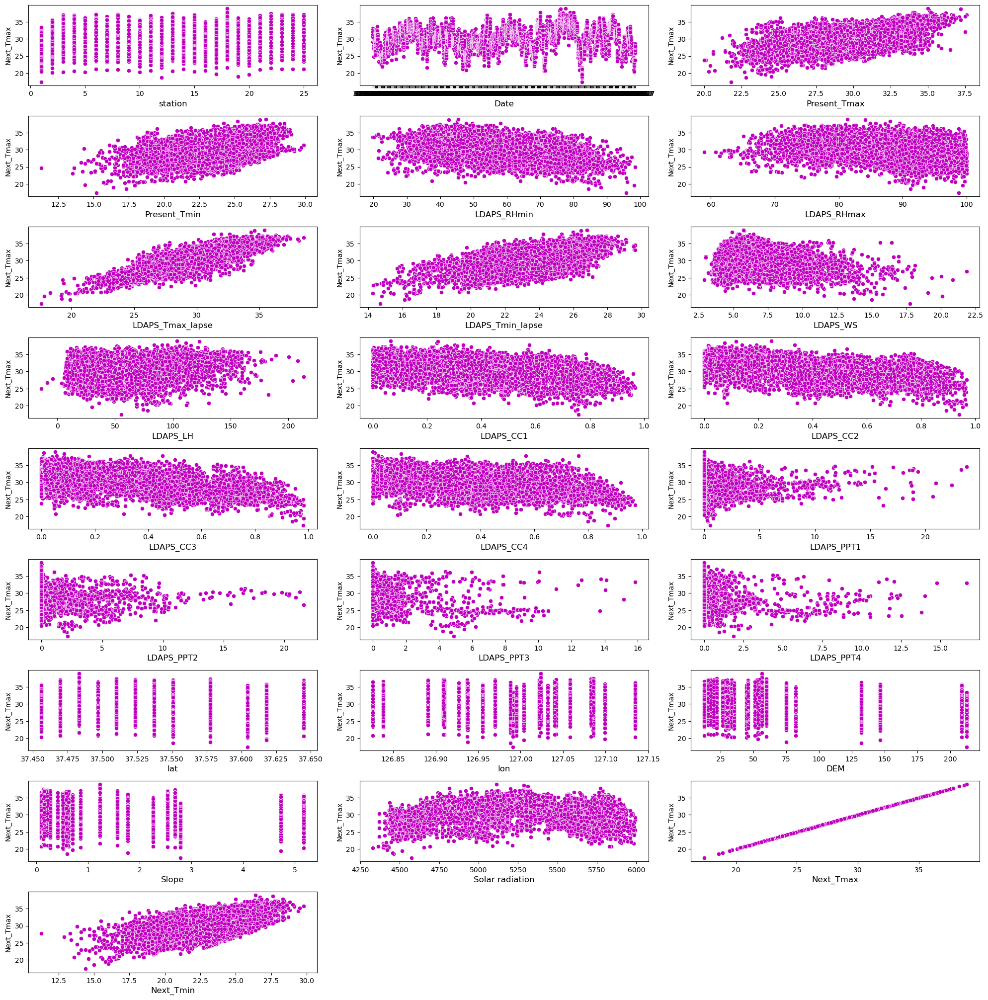

In [34]:
#Visiualizing all columns vs Next_Tmax

plt.figure(figsize=(20,22), facecolor='white')
plotnumber=1
for col in df:
    if plotnumber<=30:
        ax=plt.subplot(10,3,plotnumber) 
        sns.scatterplot(x=df[col],y=df['Next_Tmax'], color='m')
        plt.xlabel(col,fontsize=12)
    plotnumber+=1
plt.tight_layout()

## Multivariate Analysis

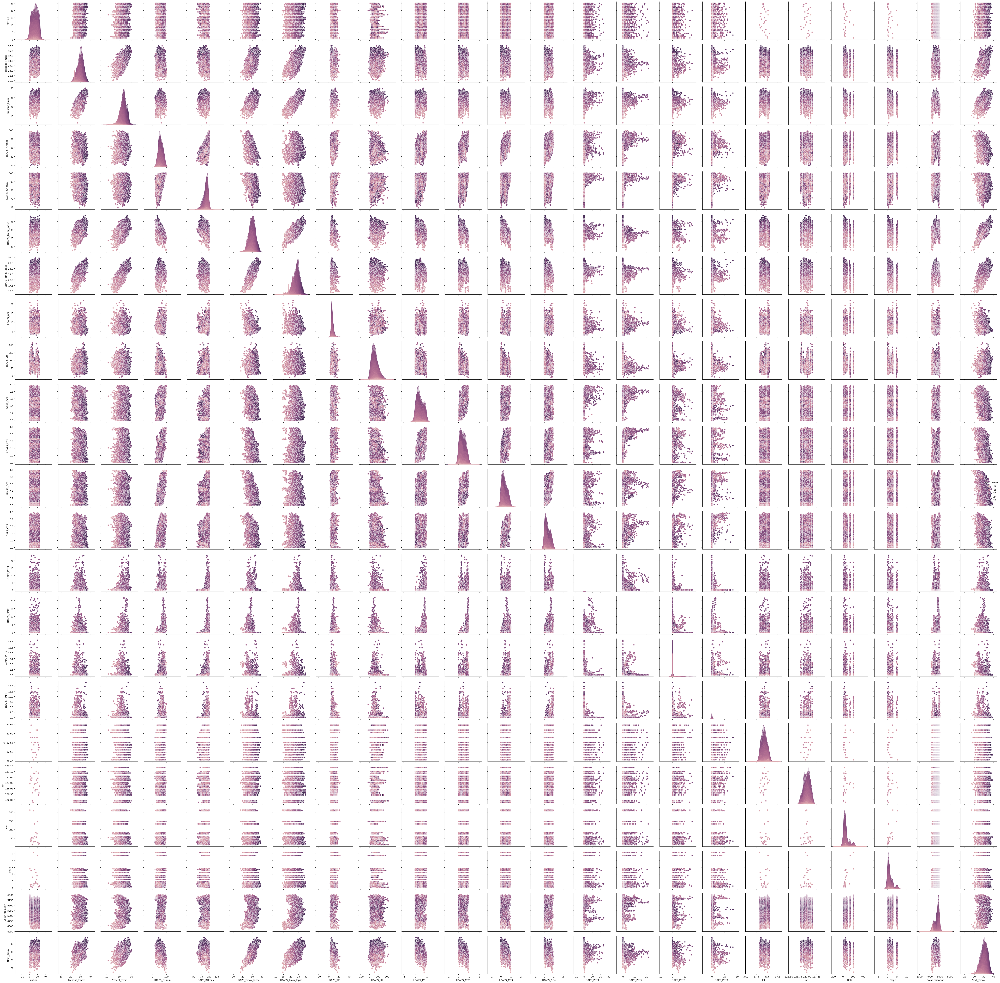

In [36]:
# For 'Next_Tmin'

sns.pairplot(df, hue='Next_Tmin')
plt.tight_layout()

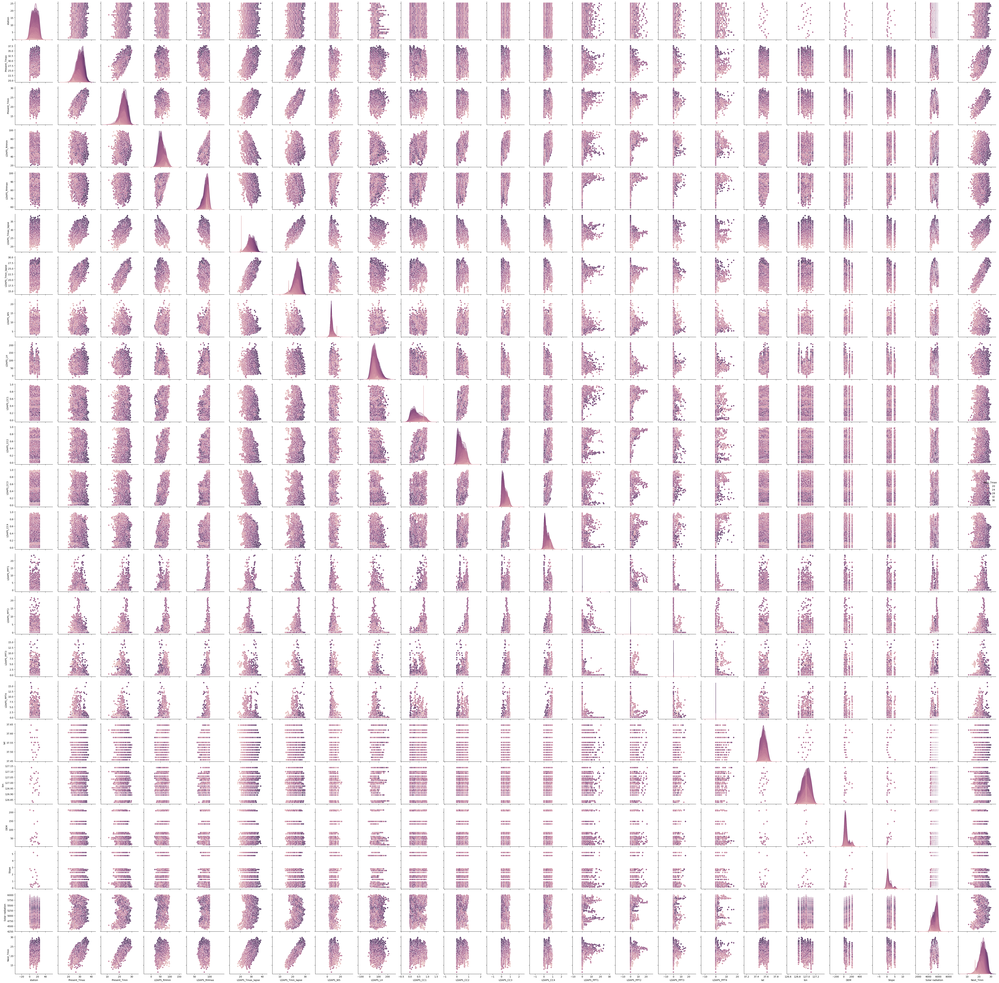

In [37]:
# For 'Next_Tmax'

sns.pairplot(df, hue='Next_Tmax')
plt.tight_layout()

In [21]:
# Converting Date column to datetime format

df['Date'] = pd.to_datetime(df['Date'])

In [25]:
columns = ['station', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin', 'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon', 'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin']

## Checking for outliers

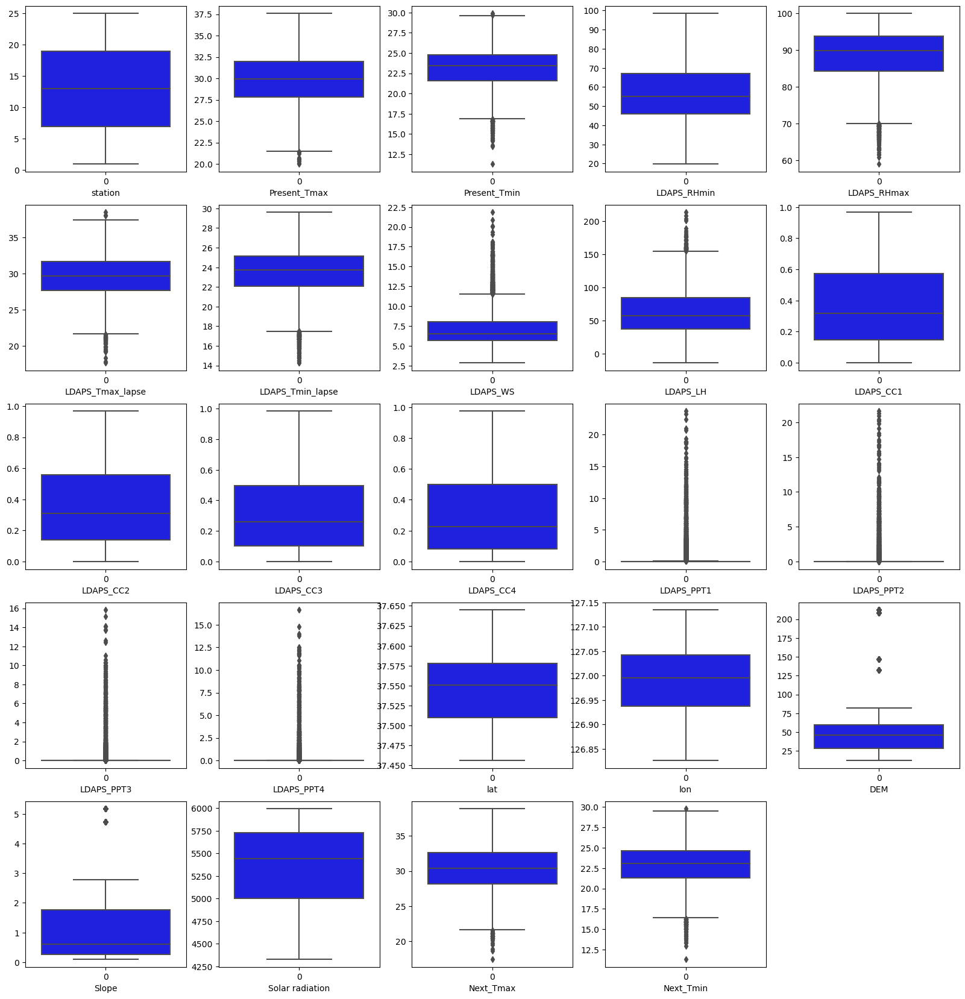

In [26]:
plt.figure(figsize=(20,25))
pnum=1
for i in columns:
    if pnum<=30:
        plt.subplot(6,5,pnum)
        sns.boxplot(df[i],color='b')
        plt.xlabel(i)
    pnum+=1
plt.show()

There is ouliers presented in 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH', 'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'DEM', 'Slope', 'Next_Tmax', 'Next_Tmin'.

## Removing the outliers

In [27]:
from scipy.stats import zscore

outliers=df[['Present_Tmax', 'Present_Tmin', 'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH', 'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'DEM', 'Slope', 'Next_Tmax', 'Next_Tmin']]
z=np.abs(zscore(outliers))
z

,Present_Tmax,Present_Tmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,DEM,Slope,Next_Tmax,Next_Tmin
0,0.353318,0.748029,0.382768,0.525269,0.215525,0.126423,0.206603,0.305589,0.275777,0.239969,0.224971,2.769091,1.111162,0.366861,0.689265
1,0.725138,0.664721,0.311697,0.078334,0.223368,0.644133,0.313359,0.305589,0.275777,0.239969,0.224971,0.315828,0.543220,0.083068,0.165513
2,0.624033,0.043400,0.609425,0.160080,0.449896,0.439100,1.244497,0.305589,0.275777,0.239969,0.224971,0.526719,0.723891,0.275895,0.398527
3,0.758840,0.085054,1.128335,0.028710,0.079238,0.663353,0.096026,0.305589,0.275777,0.239969,0.224971,0.298272,0.928888,0.468721,0.559681
4,0.556630,0.539758,0.249244,0.171981,0.010803,0.624327,1.349989,0.305589,0.275777,0.239969,0.224971,0.494848,0.549485,0.308032,0.165513
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7745,2.240616,2.247578,1.402898,0.614083,2.223667,0.225479,1.569844,0.305589,0.275777,0.239969,0.224971,0.655747,0.500966,0.848928,2.099366
7746,2.442826,2.414195,0.648815,0.990460,2.432415,0.609132,0.583486,0.305589,0.275777,0.239969,0.224971,0.735482,0.820711,0.720377,2.341098
7747,2.173212,2.539157,1.318376,1.110333,2.021883,0.434188,0.283984,0.305589,0.275777,0.239969,0.224971,0.852919,0.804538,0.623964,1.938212
7748,2.173212,2.289232,1.537141,0.886737,2.039881,0.253241,0.452772,0.305589,0.275777,0.239969,0.224971,0.821476,0.755800,0.527550,1.656192


In [28]:
threshold=3
print(np.where(z>3))

(array([  25,   25,   26, ..., 7581, 7582, 7582], dtype=int64), array([5, 8, 8, ..., 1, 1, 4], dtype=int64))


In [29]:
df_new=df[(z<3).all(axis=1)]  
df_new

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7745,21.0,2017-08-30,23.1,17.8,24.688997,78.261383,27.812697,18.303014,6.603253,9.614074,...,0.0,0.0,0.0,37.5507,127.040,26.2980,0.5721,4456.024414,27.6,17.7
7746,22.0,2017-08-30,22.5,17.4,30.094858,83.690018,26.704905,17.814038,5.768083,82.146707,...,0.0,0.0,0.0,37.5102,127.086,21.9668,0.1332,4441.803711,28.0,17.1
7747,23.0,2017-08-30,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.0,0.0,0.0,37.5372,126.891,15.5876,0.1554,4443.313965,28.3,18.1
7748,24.0,2017-08-30,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.0,0.0,0.0,37.5237,126.909,17.2956,0.2223,4438.373535,28.6,18.8


849 rows have been removed as outliers.

In [30]:
# Checking the data loss percentage after removing the outliers

print("Data Loss Percentage:", ((df.shape[0]-df_new.shape[0])/df.shape[0])*100)   

Data Loss Percentage: 11.188719030047443


## Checking for skewness

In [31]:
df=df_new

In [32]:
df.skew()

station            -0.001594
Present_Tmax       -0.269936
Present_Tmin       -0.221250
LDAPS_RHmin         0.309567
LDAPS_RHmax        -0.686083
LDAPS_Tmax_lapse   -0.110563
LDAPS_Tmin_lapse   -0.379269
LDAPS_WS            1.085685
LDAPS_LH            0.567050
LDAPS_CC1           0.594835
LDAPS_CC2           0.505774
LDAPS_CC3           0.701288
LDAPS_CC4           0.708754
LDAPS_PPT1          3.724580
LDAPS_PPT2          4.854967
LDAPS_PPT3          5.516862
LDAPS_PPT4          5.924324
lat                 0.106983
lon                -0.277547
DEM                 1.764698
Slope               1.590130
Solar radiation    -0.520157
Next_Tmax          -0.267526
Next_Tmin          -0.234328
dtype: float64

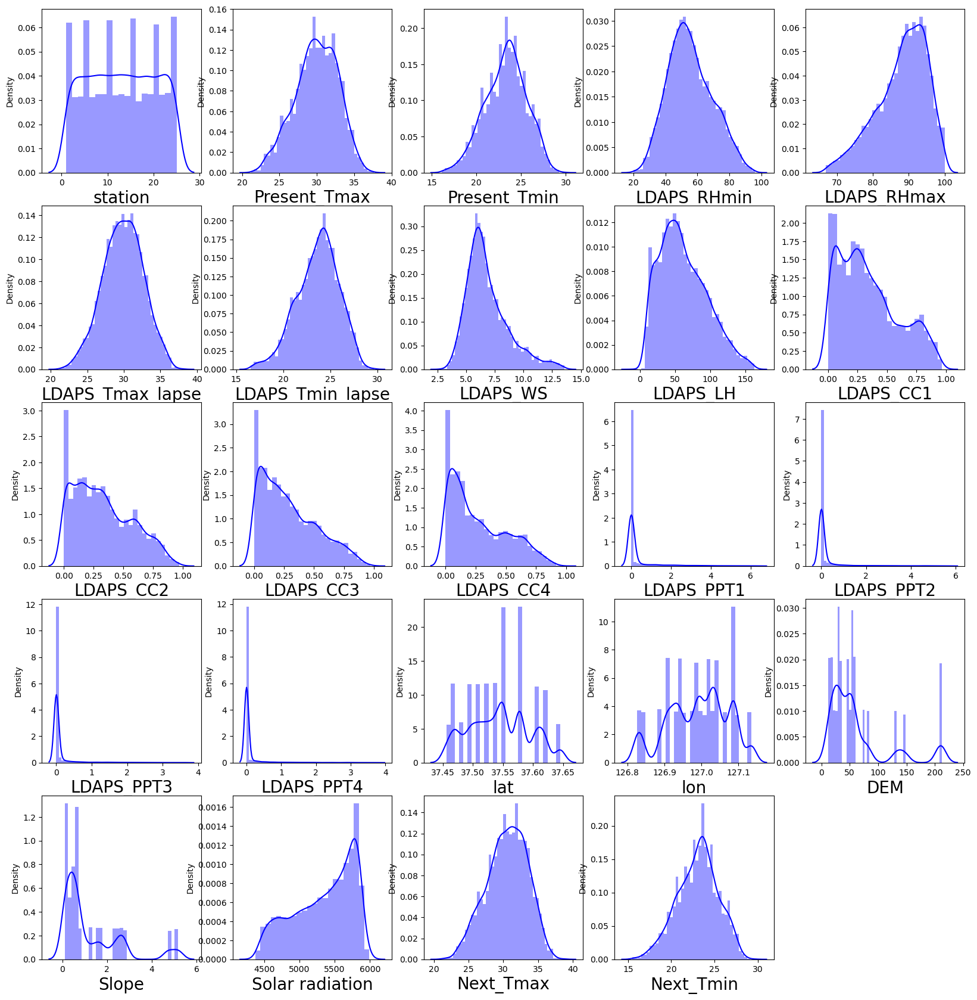

<Figure size 640x480 with 0 Axes>

In [34]:
plt.figure(figsize=(20,25), facecolor='white')

plotnumber=1

for i in columns:   
    if plotnumber<=30:
        plt.subplot(6,5,plotnumber)
        sns.distplot(df[i],color='b')
        plt.xlabel(i,fontsize=20)
    plotnumber+=1
plt.show()
plt.tight_layout()

Some features have negative skewness (data is skewed to the left) - LDAPS_RHmax and Solar radiation.

Some features have positive skewness (data is skewed to the left) - LDAPS_WS, LDAPS_LH, LDAPS_CC1, LDAPS_CC2, LDAPS_CC3, LDAPS_CC4, LDAPS_PPT1, LDAPS_PPT2, LDAPS_PPT3, LDAPS_PPT4, DEM and Slope. 

## Removing of skewness

In [39]:
df['LDAPS_RHmax'] = df['LDAPS_RHmax'].apply(lambda x: np.cbrt(x))
df['LDAPS_WS'] = df['LDAPS_WS'].apply(lambda x: np.cbrt(x))
df['LDAPS_LH'] = df['LDAPS_LH'].apply(lambda x: np.cbrt(x))
df['LDAPS_CC1'] = df['LDAPS_CC1'].apply(lambda x: np.cbrt(x))
df['LDAPS_CC2'] = df['LDAPS_CC2'].apply(lambda x: np.cbrt(x))
df['LDAPS_CC3'] = df['LDAPS_CC3'].apply(lambda x: np.cbrt(x))
df['LDAPS_CC4'] = df['LDAPS_CC4'].apply(lambda x: np.cbrt(x))
df['LDAPS_PPT1'] = df['LDAPS_PPT1'].apply(lambda x: np.cbrt(x))
df['LDAPS_PPT2'] = df['LDAPS_PPT2'].apply(lambda x: np.cbrt(x))
df['LDAPS_PPT3'] = df['LDAPS_PPT3'].apply(lambda x: np.cbrt(x))
df['LDAPS_PPT4'] = df['LDAPS_PPT4'].apply(lambda x: np.cbrt(x))
df['DEM'] = df['DEM'].apply(lambda x: np.cbrt(x))
df['Slope'] = df['Slope'].apply(lambda x: np.cbrt(x))
df['Solar radiation'] = df['Solar radiation'].apply(lambda x: np.cbrt(x))

In [40]:
df.skew()

station            -0.001594
Present_Tmax       -0.269936
Present_Tmin       -0.221250
LDAPS_RHmin         0.309567
LDAPS_RHmax        -0.807338
LDAPS_Tmax_lapse   -0.110563
LDAPS_Tmin_lapse   -0.379269
LDAPS_WS            0.618407
LDAPS_LH           -0.269287
LDAPS_CC1          -0.647383
LDAPS_CC2          -0.750436
LDAPS_CC3          -0.550622
LDAPS_CC4          -0.419106
LDAPS_PPT1          1.923134
LDAPS_PPT2          2.341898
LDAPS_PPT3          2.504981
LDAPS_PPT4          2.848397
lat                 0.106983
lon                -0.277547
DEM                 0.935017
Slope               0.620148
Solar radiation    -0.585368
Next_Tmax          -0.267526
Next_Tmin          -0.234328
dtype: float64

In some features the skewness hasn't been removed complately but it has been noticeably reduced.

## Checking the correlation between the target variable and the independent variables.

In [42]:
cor=df.corr()
cor

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
station,1.000000,0.110291,0.133638,-0.069582,-0.174915,0.066863,0.104401,0.026297,-0.135306,0.011645,...,-0.014984,-0.006384,0.006527,-0.241811,-0.122829,-0.292694,-0.132486,-0.032490,0.106378,0.129110
Present_Tmax,0.110291,1.000000,0.610428,-0.154266,-0.292279,0.540680,0.616886,-0.092728,0.113231,-0.272226,...,-0.081410,-0.029802,-0.036883,-0.052041,0.011132,-0.153586,-0.094407,-0.052474,0.586943,0.615950
Present_Tmin,0.133638,0.610428,1.000000,0.151385,-0.036636,0.441577,0.764258,0.025005,-0.010690,0.108341,...,0.106785,0.037673,-0.069277,-0.072707,-0.043201,-0.247211,-0.156232,0.032034,0.438813,0.785946
LDAPS_RHmin,-0.069582,-0.154266,0.151385,1.000000,0.548100,-0.555583,0.129481,0.211513,0.011975,0.562907,...,0.515951,0.403139,0.251817,0.090054,-0.093969,0.081474,0.095539,0.255268,-0.433872,0.134518
LDAPS_RHmax,-0.174915,-0.292279,-0.036636,0.548100,1.000000,-0.380578,-0.137818,0.071506,0.306100,0.394810,...,0.337958,0.208340,0.120769,0.194020,0.020198,0.172053,0.196778,0.153000,-0.296228,-0.094289
LDAPS_Tmax_lapse,0.066863,0.540680,0.441577,-0.555583,-0.380578,1.000000,0.621299,-0.200462,-0.007354,-0.370644,...,-0.339753,-0.271119,-0.219331,-0.038285,0.106354,-0.143381,-0.120219,0.021628,0.816861,0.553227
LDAPS_Tmin_lapse,0.104401,0.616886,0.764258,0.129481,-0.137818,0.621299,1.000000,-0.035707,-0.143110,0.107076,...,0.034538,-0.010689,-0.099117,-0.090587,-0.024177,-0.180221,-0.165030,0.119209,0.546479,0.875382
LDAPS_WS,0.026297,-0.092728,0.025005,0.211513,0.071506,-0.200462,-0.035707,1.000000,-0.047453,0.197586,...,0.175337,0.135977,0.209263,-0.019841,-0.077600,0.136510,0.107177,0.139612,-0.250767,0.001590
LDAPS_LH,-0.135306,0.113231,-0.010690,0.011975,0.306100,-0.007354,-0.143110,-0.047453,1.000000,-0.127494,...,-0.049982,0.022660,0.042913,0.091063,0.004804,0.094372,0.094506,-0.028654,0.140181,-0.054716
LDAPS_CC1,0.011645,-0.272226,0.108341,0.562907,0.394810,-0.370644,0.107076,0.197586,-0.127494,1.000000,...,0.474548,0.263430,0.210027,-0.019674,-0.014544,-0.031653,-0.035318,0.231317,-0.391840,0.071597


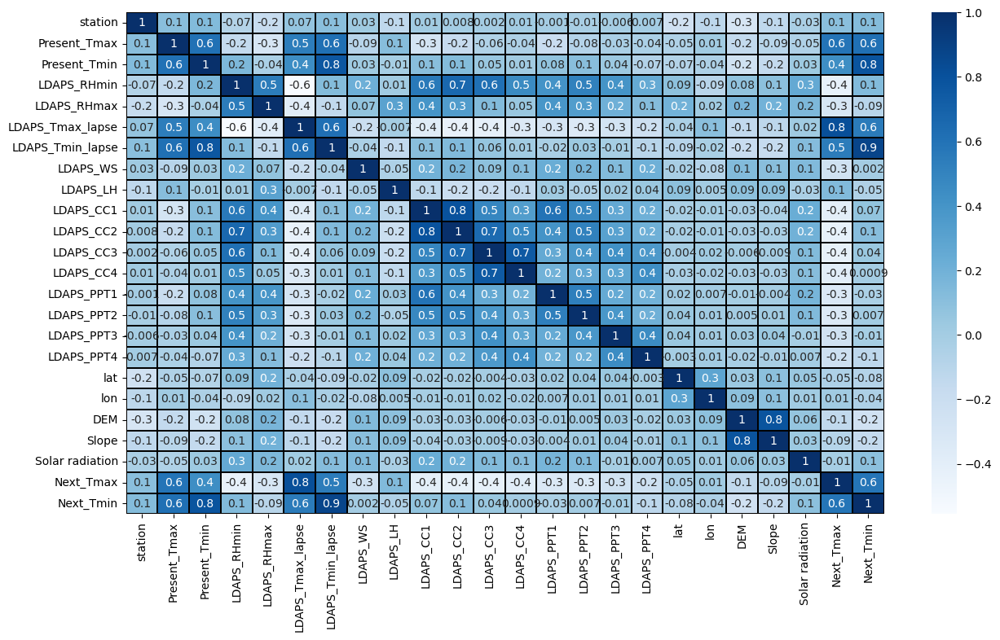

In [43]:
# Vusualizing the correlation

plt.figure(figsize=(15,8))
sns.heatmap(df.corr(), linewidths=0.1,fmt='.1g',linecolor='black', annot = True, cmap = 'Blues')
plt.yticks(rotation=0);
plt.show()

## Correlation with 'Next_Tmax' as a target variable

In [44]:
#Correlation when we have 'Next_Tmax' as a target

cor_Next_Tmax=cor['Next_Tmax'].sort_values(ascending=False)
cor_Next_Tmax

Next_Tmax           1.000000
LDAPS_Tmax_lapse    0.816861
Present_Tmax        0.586943
Next_Tmin           0.580951
LDAPS_Tmin_lapse    0.546479
Present_Tmin        0.438813
LDAPS_LH            0.140181
station             0.106378
lon                 0.010567
Solar radiation    -0.014187
lat                -0.048616
Slope              -0.086224
DEM                -0.137770
LDAPS_PPT4         -0.225697
LDAPS_PPT3         -0.250562
LDAPS_WS           -0.250767
LDAPS_RHmax        -0.296228
LDAPS_PPT1         -0.329012
LDAPS_PPT2         -0.333216
LDAPS_CC4          -0.385048
LDAPS_CC1          -0.391840
LDAPS_CC3          -0.428112
LDAPS_CC2          -0.430035
LDAPS_RHmin        -0.433872
Name: Next_Tmax, dtype: float64

Temperature is highly correlated with Target Feature and cloud cover related feature is moderately correlated with Target Feature.

## Visualizing correlation with 'Next_Tmax'

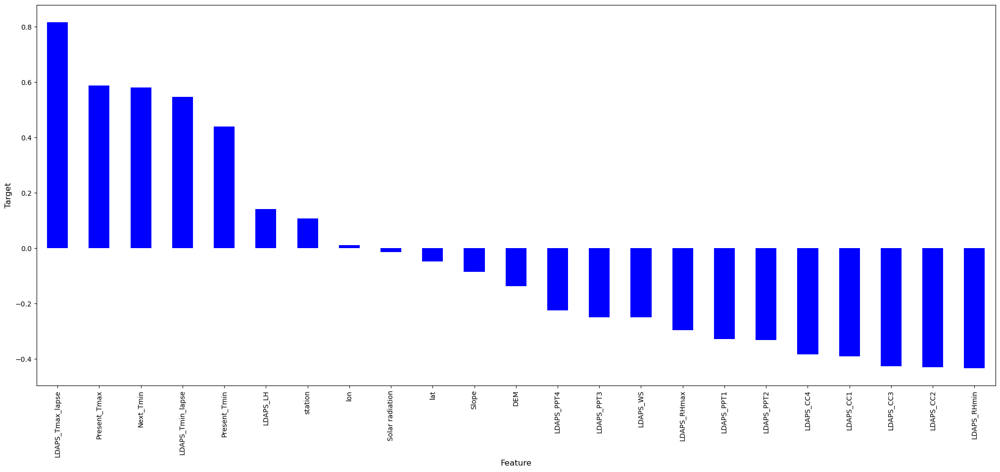

In [45]:
plt.figure(figsize=(25,10))

df_new.corr()['Next_Tmax'].sort_values(ascending=False).drop(['Next_Tmax']).plot(kind='bar',color='b')
plt.xlabel('Feature', fontsize=12)
plt.ylabel('Target', fontsize=12)
plt.show()

## Correlation with 'Next_Tmin' as a target variable

In [46]:
#Correlation when we have 'Next_Tmin' as a target

cor_Next_Tmin=cor['Next_Tmin'].sort_values(ascending=False)
cor_Next_Tmin

Next_Tmin           1.000000
LDAPS_Tmin_lapse    0.875382
Present_Tmin        0.785946
Present_Tmax        0.615950
Next_Tmax           0.580951
LDAPS_Tmax_lapse    0.553227
LDAPS_RHmin         0.134518
station             0.129110
LDAPS_CC2           0.118456
Solar radiation     0.095717
LDAPS_CC1           0.071597
LDAPS_CC3           0.043951
LDAPS_PPT2          0.006755
LDAPS_WS            0.001590
LDAPS_CC4           0.000856
LDAPS_PPT3         -0.014580
LDAPS_PPT1         -0.034697
lon                -0.041574
LDAPS_LH           -0.054716
lat                -0.076705
LDAPS_RHmax        -0.094289
LDAPS_PPT4         -0.118479
Slope              -0.155908
DEM                -0.245138
Name: Next_Tmin, dtype: float64

Temperature related feature are moderately or highly correlated with Target Feature.

## Visualizing correlation with 'Next_Tmin'

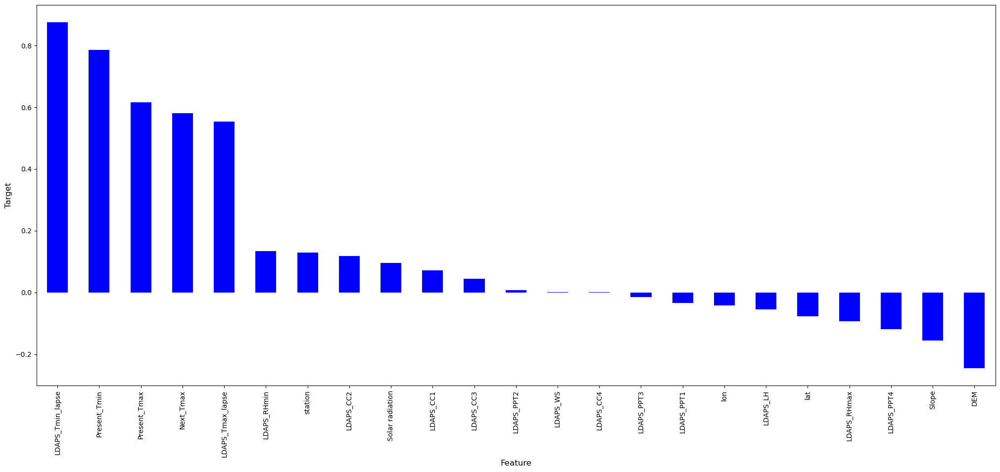

In [47]:
plt.figure(figsize=(25,10))

df_new.corr()['Next_Tmin'].sort_values(ascending=False).drop(['Next_Tmin']).plot(kind='bar',color='b')
plt.xlabel('Feature', fontsize=12)
plt.ylabel('Target', fontsize=12)
plt.show()

# Regression Task and Next_Tmax as a target.

## Separating features and label

In [50]:
x1=df.drop(['Next_Tmax', 'Date'],axis=1)
y1=df['Next_Tmax']

## Feature Scaling using Standard Scalarization

In [51]:
from sklearn.preprocessing import StandardScaler

scaler=StandardScaler()

x1=pd.DataFrame(scaler.fit_transform(x1), columns=x1.columns)
x1

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmin
0,-1.672719,-0.425704,-0.814460,0.195915,0.449907,-0.662498,-0.289928,0.064902,0.391544,-0.130071,...,-0.539276,-0.484864,-0.46478,-0.406977,1.211166,0.002925,2.365987,1.291856,1.486912,-0.790587
1,-1.533959,0.690215,-0.727785,-0.236604,0.379696,-0.016693,0.171379,-0.619328,-0.109908,-0.165968,...,-0.539276,-0.484864,-0.46478,-0.406977,1.211166,0.518733,-0.135855,-0.415651,1.217515,-0.239151
2,-1.395198,0.585598,0.008945,-0.494494,-0.555174,0.070769,0.409475,-0.338400,-1.419304,-0.237308,...,-0.539276,-0.484864,-0.46478,-0.406977,0.671467,0.845830,-0.480979,-0.860642,1.204874,0.354704
3,-1.256438,0.725088,0.052282,0.194767,1.171085,-0.069787,-0.146681,-0.646406,0.292656,-0.205853,...,-0.539276,-0.484864,-0.46478,-0.406977,2.018714,0.392926,-0.109921,1.169366,1.190392,0.524376
4,-1.117678,0.515853,-0.597774,0.045667,0.317781,-0.284509,-0.074752,-0.591564,1.252038,-0.528243,...,-0.539276,-0.484864,-0.46478,-0.406977,0.133768,1.814542,-0.424208,-0.428311,1.196079,-0.239151
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6734,1.102482,-2.378563,-2.374595,-2.226900,-1.400805,-0.757521,-2.400625,-0.059838,-2.230306,-1.282481,...,-0.539276,-0.484864,-0.46478,-0.406977,0.133768,0.619378,-0.733388,-0.333751,-2.173629,-2.275223
6735,1.241243,-2.587798,-2.547943,-1.836710,-0.596233,-1.160213,-2.620034,-0.570357,0.704151,-1.140498,...,-0.539276,-0.484864,-0.46478,-0.406977,-0.675779,1.198089,-0.912738,-1.234080,-2.211178,-2.529732
6736,1.380003,-2.308818,-2.677955,-2.078766,-1.308808,-1.288468,-2.188536,-0.331839,0.458660,-1.591457,...,-0.539276,-0.484864,-0.46478,-0.406977,-0.136081,-1.255142,-1.226213,-1.158188,-2.207186,-2.105550
6737,1.518763,-2.308818,-2.417932,-2.273699,-1.547905,-1.049238,-2.207453,-0.095284,-0.263215,-1.500686,...,-0.539276,-0.484864,-0.46478,-0.406977,-0.405930,-1.028689,-1.134959,-0.966122,-2.220247,-1.808623


## Checking Variance Inflation Factor VIF

In [52]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif=pd.DataFrame()
vif['VIF values']=[variance_inflation_factor(x1.values, i) for i in range(len(x1.columns))]
vif['Features']=x1.columns

vif

,VIF values,Features
0,1.245715,station
1,2.709653,Present_Tmax
2,3.300991,Present_Tmin
3,5.982943,LDAPS_RHmin
4,2.260797,LDAPS_RHmax
5,6.793701,LDAPS_Tmax_lapse
6,8.860336,LDAPS_Tmin_lapse
7,1.230593,LDAPS_WS
8,1.457627,LDAPS_LH
9,4.067834,LDAPS_CC1


VIF is low.

# Machine Learning for Regression problem with Next_Tmax as target

In [53]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import GradientBoostingRegressor

from sklearn.metrics import accuracy_score, confusion_matrix,classification_report,f1_score
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

## Finding the best random state

In [54]:
maxAccu=0
maxRS=0
for i in range(1,200):
    x1_train,x1_test,y1_train,y1_test=train_test_split(x1,y1,test_size=0.20,random_state=i)
    lr=LinearRegression()
    lr.fit(x1_train,y1_train)
    pred=lr.predict(x1_test)
    acc=r2_score(y1_test,pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Maximum R2 score is:",maxAccu,"on random state",maxRS)

Maximum R2 score is: 0.8041093762225453 on random state 84


In [55]:
x1.head()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmin
0,-1.672719,-0.425704,-0.814460,0.195915,0.449907,-0.662498,-0.289928,0.064902,0.391544,-0.130071,...,-0.539276,-0.484864,-0.46478,-0.406977,1.211166,0.002925,2.365987,1.291856,1.486912,-0.790587
1,-1.533959,0.690215,-0.727785,-0.236604,0.379696,-0.016693,0.171379,-0.619328,-0.109908,-0.165968,...,-0.539276,-0.484864,-0.46478,-0.406977,1.211166,0.518733,-0.135855,-0.415651,1.217515,-0.239151
2,-1.395198,0.585598,0.008945,-0.494494,-0.555174,0.070769,0.409475,-0.338400,-1.419304,-0.237308,...,-0.539276,-0.484864,-0.46478,-0.406977,0.671467,0.845830,-0.480979,-0.860642,1.204874,0.354704
3,-1.256438,0.725088,0.052282,0.194767,1.171085,-0.069787,-0.146681,-0.646406,0.292656,-0.205853,...,-0.539276,-0.484864,-0.46478,-0.406977,2.018714,0.392926,-0.109921,1.169366,1.190392,0.524376
4,-1.117678,0.515853,-0.597774,0.045667,0.317781,-0.284509,-0.074752,-0.591564,1.252038,-0.528243,...,-0.539276,-0.484864,-0.46478,-0.406977,0.133768,1.814542,-0.424208,-0.428311,1.196079,-0.239151


In [56]:
y1.head()

0    29.1
1    30.5
2    31.1
3    31.7
4    31.2
Name: Next_Tmax, dtype: float64

In [57]:
x1_train,x1_test,y1_train,y1_test=train_test_split(x1,y1,test_size=0.3, random_state=maxRS)

In [58]:
x1_train.shape

(4717, 23)

In [59]:
y1_train.shape

(4717,)

In [60]:
x1_test.shape

(2022, 23)

In [61]:
y1_test.shape

(2022,)

## Linear Regression

In [62]:
lr=LinearRegression()

In [63]:
lr.fit(x1_train,y1_train)

LinearRegression()

In [64]:
lr.score(x1_train, y1_train)

0.7748871034015531

In [65]:
lrpred=lr.predict(x1_test)

In [66]:
print('R2_score: ', r2_score(y1_test,lrpred))
print('Mean Absolute Error: ', mean_absolute_error(y1_test,lrpred))
print('Mean Squared Error: ', mean_squared_error(y1_test,lrpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y1_test,lrpred)))

R2_score:  0.7927266360788122
Mean Absolute Error:  1.046188376375119
Mean Squared Error:  1.8335650301732667
Root Mean Squared Error:  1.354091957798017


## Decision Tree Regressor

In [67]:
dtr = DecisionTreeRegressor()

In [68]:
dtr.fit(x1_train,y1_train)

DecisionTreeRegressor()

In [69]:
dtrpred=dtr.predict(x1_test)

In [70]:
dtr.score(x1_train, y1_train)

1.0

In [71]:
print('R2_score: ', r2_score(y1_test,dtrpred))
print('Mean Absolute Error: ', mean_absolute_error(y1_test,dtrpred))
print('Mean Squared Error: ', mean_squared_error(y1_test,dtrpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y1_test,dtrpred)))

R2_score:  0.7714164884428251
Mean Absolute Error:  1.0209693372898119
Mean Squared Error:  2.0220771513353113
Root Mean Squared Error:  1.4219975918880141


## Support Vector Regressor

In [72]:
svr=SVR()
svr.fit(x1_train,y1_train)
svrpred=svr.predict(x1_test)

In [73]:
svr.score(x1_train, y1_train)

0.8864281044405772

In [74]:
print('R2_score: ', r2_score(y1_test,svrpred))
print('Mean Absolute Error: ', mean_absolute_error(y1_test,svrpred))
print('Mean Squared Error: ', mean_squared_error(y1_test,svrpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y1_test,svrpred)))

R2_score:  0.8750728764545564
Mean Absolute Error:  0.7750878441353622
Mean Squared Error:  1.1051203141574795
Root Mean Squared Error:  1.0512470281325315


## Random Forest Regressor

In [75]:
rfr=RandomForestRegressor(n_estimators=200, random_state=maxRS)
rfr.fit(x1_train, y1_train)
rfrpred= rfr.predict(x1_test)

In [76]:
rfr.score(x1_train, y1_train)

0.9838452746069382

In [77]:
print('R2_score: ', r2_score(y1_test,rfrpred))
print('Mean Absolute Error: ', mean_absolute_error(y1_test,rfrpred))
print('Mean Squared Error: ', mean_squared_error(y1_test,rfrpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y1_test,rfrpred)))

R2_score:  0.8995133563636392
Mean Absolute Error:  0.7144920870425323
Mean Squared Error:  0.888916898367953
Root Mean Squared Error:  0.942823895734486


## AdaBoost Regressor

In [78]:
abr=AdaBoostRegressor()
abr.fit(x1_train,y1_train)
abrpred=abr.predict(x1_test)

In [79]:
abr.score(x1_train, y1_train)

0.7560278758286166

In [80]:
print('R2_score: ', r2_score(y1_test,abrpred))
print('Mean Absolute Error: ', mean_absolute_error(y1_test,abrpred))
print('Mean Squared Error: ', mean_squared_error(y1_test,abrpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y1_test,abrpred)))

R2_score:  0.7596933605596885
Mean Absolute Error:  1.1709734121528457
Mean Squared Error:  2.125781346240651
Root Mean Squared Error:  1.4580059486300634


## Ridge

In [81]:
rr=Ridge()
rr.fit(x1_train,y1_train)
rrpred=rr.predict(x1_test)

In [82]:
rr.score(x1_train, y1_train)

0.7748868882106117

In [83]:
print('R2_score: ', r2_score(y1_test,rrpred))
print('Mean Absolute Error: ', mean_absolute_error(y1_test,rrpred))
print('Mean Squared Error: ', mean_squared_error(y1_test,rrpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y1_test,rrpred)))

R2_score:  0.7927237018923489
Mean Absolute Error:  1.0461798091140628
Mean Squared Error:  1.8335909863385425
Root Mean Squared Error:  1.3541015421077336


## Lasso

In [84]:
lasso=Lasso()
lasso.fit(x1_train,y1_train)
lassopred=lasso.predict(x1_test)

In [85]:
lasso.score(x1_train, y1_train)

0.5381292546516789

In [86]:
print('R2_score: ', r2_score(y1_test, lassopred))
print('Mean Absolute Error: ', mean_absolute_error(y1_test, lassopred))
print('Mean Squared Error: ', mean_squared_error(y1_test, lassopred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y1_test, lassopred)))

R2_score:  0.5506757511856714
Mean Absolute Error:  1.5990297739512034
Mean Squared Error:  3.9747761808318307
Root Mean Squared Error:  1.9936840724728255


## KNeighbors Regressor

In [87]:
knr = KNeighborsRegressor()
knr.fit(x1_train,y1_train)
knrpred=knr.predict(x1_test)

In [88]:
knr.score(x1_train, y1_train)

0.8866034271287405

In [89]:
print('R2_score: ', r2_score(y1_test, knrpred))
print('Mean Absolute Error: ', mean_absolute_error(y1_test, knrpred))
print('Mean Squared Error: ', mean_squared_error(y1_test, knrpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y1_test, knrpred)))

R2_score:  0.8511136987206992
Mean Absolute Error:  0.862106824925816
Mean Squared Error:  1.3170660731948567
Root Mean Squared Error:  1.1476349912732953


## GradientBoosting Regressor

In [90]:
gbr=GradientBoostingRegressor()
gbr.fit(x1_train,y1_train)
gbrpred=gbr.predict(x1_test)

In [91]:
gbr.score(x1_train, y1_train)

0.8684125596445236

In [92]:
print('R2_score: ', r2_score(y1_test, gbrpred))
print('Mean Absolute Error: ', mean_absolute_error(y1_test, gbrpred))
print('Mean Squared Error: ', mean_squared_error(y1_test, gbrpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y1_test, gbrpred)))

R2_score:  0.8540668557669719
Mean Absolute Error:  0.878080809781578
Mean Squared Error:  1.2909420918678862
Root Mean Squared Error:  1.136196326286917


RandomForest Regressor gives us the highest R2 score 0.90.

## Cross Validation Score

In [93]:
from sklearn.model_selection import cross_val_score

In [94]:
#CV score for Linear Regression

score=cross_val_score(lr,x1,y1, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print("Difference between R2 score and CVS is: ",(r2_score(y1_test,lrpred)-score.mean())*100)

Score:  [0.73919224 0.68028593 0.69909034 0.76256169 0.69134989]
Mean Score:  0.7144960176096532
Std deviation:  0.031188524768560745
Difference between R2 score and CVS is:  7.823061846915902


In [95]:
#CV score for DTR

score=cross_val_score(dtr,x1,y1, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print("Difference between R2 score and CVS is: ",(r2_score(y1_test,dtrpred)-score.mean())*100)

Score:  [0.40216625 0.43340485 0.33726807 0.51486521 0.46654855]
Mean Score:  0.4308505864661676
Std deviation:  0.05986619381775933
Difference between R2 score and CVS is:  34.05659019766575


In [96]:
#CV score for SVR

score=cross_val_score(svr,x1,y1, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print("Difference between R2 score and CVS is: ",(r2_score(y1_test,svrpred)-score.mean())*100)

Score:  [0.70314458 0.61444558 0.68624826 0.76486505 0.69665881]
Mean Score:  0.6930724582800033
Std deviation:  0.04795256231270762
Difference between R2 score and CVS is:  18.200041817455315


In [97]:
#CV score for RFR

score=cross_val_score(rfr,x1,y1, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print("Difference between R2 score and CVS is: ",(r2_score(y1_test,rfrpred)-score.mean())*100)

Score:  [0.74165195 0.67090342 0.67482929 0.72218808 0.65186128]
Mean Score:  0.6922868080787558
Std deviation:  0.03384447028477162
Difference between R2 score and CVS is:  20.72265482848834


In [98]:
#CV score for ABR

score=cross_val_score(abr,x1,y1, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print("Difference between R2 score and CVS is: ",(r2_score(y1_test,abrpred)-score.mean())*100)

Score:  [0.69431856 0.62034377 0.65556939 0.70045828 0.61546474]
Mean Score:  0.6572309464360302
Std deviation:  0.035642486523512845
Difference between R2 score and CVS is:  10.24624141236583


In [99]:
#CV score for Ridge Regressor

score=cross_val_score(rr,x1,y1, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print("Difference between R2 score and CVS is: ",(r2_score(y1_test,rrpred)-score.mean())*100)

Score:  [0.73937013 0.68026238 0.69902976 0.76264815 0.69136301]
Mean Score:  0.714534687463916
Std deviation:  0.03125260231241046
Difference between R2 score and CVS is:  7.818901442843284


In [100]:
#CV score for Lasso Regressor

score=cross_val_score(lasso,x1,y1, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print("Difference between R2 score and CVS is: ",(r2_score(y1_test,lassopred)-score.mean())*100)

Score:  [0.4929044  0.47299483 0.56854171 0.42079738 0.52789789]
Mean Score:  0.4966272403537687
Std deviation:  0.049944093400873926
Difference between R2 score and CVS is:  5.404851083190265


In [101]:
#CV score for KNeighbors Regressor

score=cross_val_score(knr,x1,y1, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print("Difference between R2 score and CVS is: ",(r2_score(y1_test,knrpred)-score.mean())*100)

Score:  [0.6367817  0.48751783 0.51917752 0.64598252 0.58593468]
Mean Score:  0.5750788488755976
Std deviation:  0.06283997218791071
Difference between R2 score and CVS is:  27.603484984510164


In [102]:
#CV score for GradientBoosting Regressor

score=cross_val_score(gbr,x1,y1, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print("Difference between R2 score and CVS is: ",(r2_score(y1_test,gbrpred)-score.mean())*100)

Score:  [0.73495085 0.65771314 0.69585508 0.76776409 0.67739874]
Mean Score:  0.706736379015767
Std deviation:  0.03975629918582862
Difference between R2 score and CVS is:  14.733047675120492


Random Forest regressor has highest r2 score but the difference between r2 score and croass validation score is very high. The same for SVR and KNR. Ridge Regression has relatevaly hight r2 score and the difference between r2 score and cross validation score is very low. So we choose Ridge Regressor as our best model.

## Hyper Parameter Tuning (Next_Tmax as target)

In [103]:
from sklearn.model_selection import GridSearchCV

In [109]:
param_1= {
    'alpha': [0.01, 0.1, 1.0, 10.0],
    'fit_intercept': [True, False],
    'random_state': [0, 42, None],
    'solver': ['auto', 'svd', 'cholesky', 'lsqr', 'sparse_cg', 'sag', 'saga']
}

In [111]:
gscv_1=GridSearchCV(Ridge(),param_1,cv=5)

In [112]:
gscv_1.fit(x1_train,y1_train)

GridSearchCV(cv=5, estimator=Ridge(),
             param_grid={'alpha': [0.01, 0.1, 1.0, 10.0],
                         'fit_intercept': [True, False],
                         'random_state': [0, 42, None],
                         'solver': ['auto', 'svd', 'cholesky', 'lsqr',
                                    'sparse_cg', 'sag', 'saga']})

In [113]:
 gscv_1.best_params_

{'alpha': 1.0, 'fit_intercept': True, 'random_state': 0, 'solver': 'sparse_cg'}

In [115]:
Final_model_1=Ridge(alpha= 0.01, 
            fit_intercept=True, 
            random_state=0, 
            solver= 'sparse_cg')

In [116]:
Final_model_1.fit(x1_train, y1_train)
prediction=Final_model_1.predict(x1_test)

print("R2 score:",r2_score(y1_test,prediction))
print("Mean Absolute Error:",mean_absolute_error(y1_test,prediction))
print("Mean Squared Error:",mean_squared_error(y1_test,prediction))
print("Root Mean Squared Error:",np.sqrt(mean_squared_error(y1_test,prediction)))

R2 score: 0.7927253243952348
Mean Absolute Error: 1.046199056925027
Mean Squared Error: 1.8335766334834693
Root Mean Squared Error: 1.3540962423267666


# Saving the model (Next_Tmax as target)

In [118]:
import joblib

joblib.dump(rr, 'Next_Tmax-predict.pkl.obj')

['Next_Tmax-predict.pkl.obj']

# Regression Task and Next_Tmin as a target.

## Separating features and label

In [120]:
x2=df.drop(['Next_Tmin','Date'],axis=1)
y2=df['Next_Tmin']

## Feature Scaling using Standard Scalarization

In [121]:
from sklearn.preprocessing import StandardScaler

scaler=StandardScaler()

x2=pd.DataFrame(scaler.fit_transform(x2), columns=x2.columns)
x2

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax
0,-1.672719,-0.425704,-0.814460,0.195915,0.449907,-0.662498,-0.289928,0.064902,0.391544,-0.130071,...,-0.539276,-0.484864,-0.46478,-0.406977,1.211166,0.002925,2.365987,1.291856,1.486912,-0.489951
1,-1.533959,0.690215,-0.727785,-0.236604,0.379696,-0.016693,0.171379,-0.619328,-0.109908,-0.165968,...,-0.539276,-0.484864,-0.46478,-0.406977,1.211166,0.518733,-0.135855,-0.415651,1.217515,-0.011135
2,-1.395198,0.585598,0.008945,-0.494494,-0.555174,0.070769,0.409475,-0.338400,-1.419304,-0.237308,...,-0.539276,-0.484864,-0.46478,-0.406977,0.671467,0.845830,-0.480979,-0.860642,1.204874,0.194072
3,-1.256438,0.725088,0.052282,0.194767,1.171085,-0.069787,-0.146681,-0.646406,0.292656,-0.205853,...,-0.539276,-0.484864,-0.46478,-0.406977,2.018714,0.392926,-0.109921,1.169366,1.190392,0.399279
4,-1.117678,0.515853,-0.597774,0.045667,0.317781,-0.284509,-0.074752,-0.591564,1.252038,-0.528243,...,-0.539276,-0.484864,-0.46478,-0.406977,0.133768,1.814542,-0.424208,-0.428311,1.196079,0.228274
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6734,1.102482,-2.378563,-2.374595,-2.226900,-1.400805,-0.757521,-2.400625,-0.059838,-2.230306,-1.282481,...,-0.539276,-0.484864,-0.46478,-0.406977,0.133768,0.619378,-0.733388,-0.333751,-2.173629,-1.002969
6735,1.241243,-2.587798,-2.547943,-1.836710,-0.596233,-1.160213,-2.620034,-0.570357,0.704151,-1.140498,...,-0.539276,-0.484864,-0.46478,-0.406977,-0.675779,1.198089,-0.912738,-1.234080,-2.211178,-0.866164
6736,1.380003,-2.308818,-2.677955,-2.078766,-1.308808,-1.288468,-2.188536,-0.331839,0.458660,-1.591457,...,-0.539276,-0.484864,-0.46478,-0.406977,-0.136081,-1.255142,-1.226213,-1.158188,-2.207186,-0.763561
6737,1.518763,-2.308818,-2.417932,-2.273699,-1.547905,-1.049238,-2.207453,-0.095284,-0.263215,-1.500686,...,-0.539276,-0.484864,-0.46478,-0.406977,-0.405930,-1.028689,-1.134959,-0.966122,-2.220247,-0.660957


## Checking Variance Inflation Factor VIF

In [122]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif2=pd.DataFrame()
vif2['VIF values']=[variance_inflation_factor(x2.values, i) for i in range(len(x2.columns))]
vif2['Features']=x2.columns

vif2

,VIF values,Features
0,1.256262,station
1,2.797822,Present_Tmax
2,3.049660,Present_Tmin
3,5.943800,LDAPS_RHmin
4,2.261396,LDAPS_RHmax
5,8.289233,LDAPS_Tmax_lapse
6,7.165584,LDAPS_Tmin_lapse
7,1.244998,LDAPS_WS
8,1.495192,LDAPS_LH
9,4.068320,LDAPS_CC1


VIF is low.

# Machine Learning for Regression with Next_Tmin as target

## Finding the best random state

In [123]:
maxAccu=0
maxRS=0
for i in range(1,200):
    x2_train,x2_test,y2_train,y2_test=train_test_split(x2,y2,test_size=0.20,random_state=i)
    lr=LinearRegression()
    lr.fit(x2_train,y2_train)
    pred2=lr.predict(x2_test)
    acc2=r2_score(y2_test,pred2)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Maximum R2 score is:",maxAccu,"on random state",maxRS)

Maximum R2 score is: 0.7988882648461336 on random state 1


In [124]:
x2.head()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax
0,-1.672719,-0.425704,-0.814460,0.195915,0.449907,-0.662498,-0.289928,0.064902,0.391544,-0.130071,...,-0.539276,-0.484864,-0.46478,-0.406977,1.211166,0.002925,2.365987,1.291856,1.486912,-0.489951
1,-1.533959,0.690215,-0.727785,-0.236604,0.379696,-0.016693,0.171379,-0.619328,-0.109908,-0.165968,...,-0.539276,-0.484864,-0.46478,-0.406977,1.211166,0.518733,-0.135855,-0.415651,1.217515,-0.011135
2,-1.395198,0.585598,0.008945,-0.494494,-0.555174,0.070769,0.409475,-0.338400,-1.419304,-0.237308,...,-0.539276,-0.484864,-0.46478,-0.406977,0.671467,0.845830,-0.480979,-0.860642,1.204874,0.194072
3,-1.256438,0.725088,0.052282,0.194767,1.171085,-0.069787,-0.146681,-0.646406,0.292656,-0.205853,...,-0.539276,-0.484864,-0.46478,-0.406977,2.018714,0.392926,-0.109921,1.169366,1.190392,0.399279
4,-1.117678,0.515853,-0.597774,0.045667,0.317781,-0.284509,-0.074752,-0.591564,1.252038,-0.528243,...,-0.539276,-0.484864,-0.46478,-0.406977,0.133768,1.814542,-0.424208,-0.428311,1.196079,0.228274


In [125]:
y2.head()

0    21.2
1    22.5
2    23.9
3    24.3
4    22.5
Name: Next_Tmin, dtype: float64

In [126]:
x2_train,x2_test,y2_train,y2_test=train_test_split(x2,y2,test_size=0.3, random_state=maxRS)

In [127]:
x2_train.shape

(4717, 23)

In [128]:
y2_train.shape

(4717,)

In [129]:
x2_test.shape

(2022, 23)

In [130]:
y2_test.shape

(2022,)

## Linear Regression

In [134]:
lnr=LinearRegression()
lnr.fit(x2_train,y2_train)
lnrpred=lnr.predict(x2_test)

In [136]:
lnr.score(x2_train, y2_train)

0.8469323985808928

In [137]:
print('R2_score: ', r2_score(y2_test,lnrpred))
print('Mean Absolute Error: ', mean_absolute_error(y2_test,lnrpred))
print('Mean Squared Error: ', mean_squared_error(y2_test,lnrpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y2_test,lnrpred)))

R2_score:  0.8217034249879193
Mean Absolute Error:  0.7707088991387646
Mean Squared Error:  0.9436901306790247
Root Mean Squared Error:  0.9714371470553433


## Decision Tree Regressor

In [139]:
dt = DecisionTreeRegressor()
dt.fit(x2_train,y2_train)
dtpred=dt.predict(x2_test)

In [140]:
dt.score(x2_train, y2_train)

1.0

In [141]:
print('R2_score: ', r2_score(y2_test,dtpred))
print('Mean Absolute Error: ', mean_absolute_error(y2_test,dtpred))
print('Mean Squared Error: ', mean_squared_error(y2_test,dtpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y2_test,dtpred)))

R2_score:  0.7633148256372362
Mean Absolute Error:  0.8431256181998023
Mean Squared Error:  1.2527299703264094
Root Mean Squared Error:  1.1192542027289465


## Support Vector Regressor

In [143]:
sv=SVR()
sv.fit(x2_train,y2_train)
svpred=sv.predict(x2_test)

In [144]:
sv.score(x2_train, y2_train)

0.9341513098839596

In [145]:
print('R2_score: ', r2_score(y2_test,svpred))
print('Mean Absolute Error: ', mean_absolute_error(y2_test,svpred))
print('Mean Squared Error: ', mean_squared_error(y2_test,svpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y2_test,svpred)))

R2_score:  0.8939024274823275
Mean Absolute Error:  0.5735389084591235
Mean Squared Error:  0.5615544329280899
Root Mean Squared Error:  0.7493693568115058


## Random Forest Regressor

In [146]:
rf=RandomForestRegressor(n_estimators=200, random_state=maxRS)
rf.fit(x2_train, y2_train)
rfpred= rf.predict(x2_test)

In [147]:
rf.score(x2_train, y2_train)

0.9864343735946123

In [148]:
print('R2_score: ', r2_score(y2_test,rfpred))
print('Mean Absolute Error: ', mean_absolute_error(y2_test,rfpred))
print('Mean Squared Error: ', mean_squared_error(y2_test,rfpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y2_test,rfpred)))

R2_score:  0.8916796376514227
Mean Absolute Error:  0.5814396636993076
Mean Squared Error:  0.573319240108803
Root Mean Squared Error:  0.7571784730886127


## AdaBoost Regressor

In [150]:
ab=AdaBoostRegressor()
ab.fit(x2_train,y2_train)
abpred=ab.predict(x2_test)

In [151]:
ab.score(x2_train, y2_train)

0.8267226271020296

In [152]:
print('R2_score: ', r2_score(y2_test,abpred))
print('Mean Absolute Error: ', mean_absolute_error(y2_test,abpred))
print('Mean Squared Error: ', mean_squared_error(y2_test,abpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y2_test,abpred)))

R2_score:  0.7890881119100908
Mean Absolute Error:  0.8528553478475401
Mean Squared Error:  1.116316828967917
Root Mean Squared Error:  1.0565589566928657


## Ridge

In [153]:
ridge=Ridge()
ridge.fit(x2_train,y2_train)
ridgepred=ridge.predict(x2_test)

In [154]:
ridge.score(x2_train, y2_train)

0.8469322970619275

In [155]:
print('R2_score: ', r2_score(y2_test,ridgepred))
print('Mean Absolute Error: ', mean_absolute_error(y2_test,ridgepred))
print('Mean Squared Error: ', mean_squared_error(y2_test,ridgepred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y2_test,ridgepred)))

R2_score:  0.821711761534994
Mean Absolute Error:  0.7706961102599316
Mean Squared Error:  0.943646006908291
Root Mean Squared Error:  0.971414436226007


## Lasso

In [156]:
las=Lasso()
las.fit(x2_train,y2_train)
laspred=las.predict(x2_test)

In [157]:
las.score(x2_train, y2_train)

0.6090186935634967

In [158]:
print('R2_score: ', r2_score(y2_test, laspred))
print('Mean Absolute Error: ', mean_absolute_error(y2_test, laspred))
print('Mean Squared Error: ', mean_squared_error(y2_test, laspred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y2_test, laspred)))

R2_score:  0.5994700147360663
Mean Absolute Error:  1.1606477425336308
Mean Squared Error:  2.119929640314062
Root Mean Squared Error:  1.4559978160402791


## KNeighbors Regressor

In [164]:
kn = KNeighborsRegressor()
kn.fit(x2_train,y2_train)
knpred=kn.predict(x2_test)

In [160]:
kn.score(x2_train, y2_train)

0.915300503563459

In [165]:
print('R2_score: ', r2_score(y2_test, knpred))
print('Mean Absolute Error: ', mean_absolute_error(y2_test, knpred))
print('Mean Squared Error: ', mean_squared_error(y2_test, knpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y2_test, knpred)))

R2_score:  0.8598916310664594
Mean Absolute Error:  0.6758654797230466
Mean Squared Error:  0.7415671612265085
Root Mean Squared Error:  0.8611429389053298


## GradientBoosting Regressor

In [166]:
gb=GradientBoostingRegressor()
gb.fit(x2_train,y2_train)
gbpred=gb.predict(x2_test)

In [167]:
gb.score(x2_train, y2_train)

0.9125877601881212

In [168]:
print('R2_score: ', r2_score(y2_test, gbpred))
print('Mean Absolute Error: ', mean_absolute_error(y2_test, gbpred))
print('Mean Squared Error: ', mean_squared_error(y2_test, gbpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y2_test, gbpred)))

R2_score:  0.8748555937971075
Mean Absolute Error:  0.6311653713096422
Mean Squared Error:  0.6623657298821062
Root Mean Squared Error:  0.8138585441476339


RandomForest Regressor and Support Vector Regressor have the highest r2 score - 0.89. GradientBoosting Regressor - 0.87 andKNeighbors Regressor - 0.86.

## Cross Validation Score

In [169]:
#CV score for Linear Regression

score=cross_val_score(lnr,x2,y2, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print("Difference between R2 score and CVS is: ",(r2_score(y2_test,lnrpred)-score.mean())*100)

Score:  [0.74797418 0.68113259 0.80395908 0.86768592 0.86971982]
Mean Score:  0.7940943189518114
Std deviation:  0.0722767937661923
Difference between R2 score and CVS is:  2.760910603610789


In [170]:
#CV score for DTR

score=cross_val_score(dt,x2,y2, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print("Difference between R2 score and CVS is: ",(r2_score(y2_test,dtpred)-score.mean())*100)

Score:  [0.51381489 0.46101121 0.63565609 0.7587379  0.70855158]
Mean Score:  0.6155543335395391
Std deviation:  0.11295007169473614
Difference between R2 score and CVS is:  14.776049209769704


In [171]:
#CV score for SVR

score=cross_val_score(sv,x2,y2, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print("Difference between R2 score and CVS is: ",(r2_score(y2_test,svpred)-score.mean())*100)

Score:  [0.69293565 0.66779343 0.77077787 0.82849177 0.83499678]
Mean Score:  0.7589990980990768
Std deviation:  0.06844921114902469
Difference between R2 score and CVS is:  13.490332938325068


In [172]:
#CV score for RFR

score=cross_val_score(rf,x2,y2, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print("Difference between R2 score and CVS is: ",(r2_score(y2_test,rfpred)-score.mean())*100)

Score:  [0.73956928 0.70074452 0.80735082 0.87512608 0.85702798]
Mean Score:  0.795963733411045
Std deviation:  0.06689128144048093
Difference between R2 score and CVS is:  9.571590424037769


In [173]:
#CV score for ABR

score=cross_val_score(ab,x2,y2, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print("Difference between R2 score and CVS is: ",(r2_score(y2_test,abpred)-score.mean())*100)

Score:  [0.69810838 0.6179855  0.75968236 0.82327368 0.83851836]
Mean Score:  0.7475136563217076
Std deviation:  0.08171651002358979
Difference between R2 score and CVS is:  4.1574455588383135


In [174]:
#CV score for Ridge Regressor

score=cross_val_score(ridge,x2,y2, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print("Difference between R2 score and CVS is: ",(r2_score(y2_test,ridgepred)-score.mean())*100)

Score:  [0.74798108 0.68118824 0.80393005 0.86770305 0.86973221]
Mean Score:  0.7941069250458701
Std deviation:  0.07226380942742767
Difference between R2 score and CVS is:  2.760483648912393


In [175]:
#CV score for Lasso Regressor

score=cross_val_score(las,x2,y2, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print("Difference between R2 score and CVS is: ",(r2_score(y2_test,laspred)-score.mean())*100)

Score:  [0.54779193 0.40887063 0.57999219 0.50019864 0.63086944]
Mean Score:  0.5335445672668997
Std deviation:  0.0754825008484381
Difference between R2 score and CVS is:  6.592544746916662


In [176]:
#CV score for KNeighbors Regressor

score=cross_val_score(kn,x2,y2, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print("Difference between R2 score and CVS is: ",(r2_score(y2_test,knpred)-score.mean())*100)

Score:  [0.51377437 0.51504861 0.65752045 0.72616583 0.77599141]
Mean Score:  0.637700135976495
Std deviation:  0.10746580304336882
Difference between R2 score and CVS is:  22.219149508996438


In [177]:
#CV score for GradientBoosting Regressor

score=cross_val_score(gb,x2,y2, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print("Difference between R2 score and CVS is: ",(r2_score(y2_test,gbpred)-score.mean())*100)

Score:  [0.74363675 0.6979109  0.81994435 0.88161688 0.88241381]
Mean Score:  0.8051045393904712
Std deviation:  0.07391866473260454
Difference between R2 score and CVS is:  6.975105440663631


Random Forest Regression has high r2 score 0.89 and the difference between r2 score and cross validation score is low - 9.57. Support vector regressor also has the same r2 score 0.89 but the difference between the r2 score and the cross validation score is high - 13.49. The best model to use is Random Forest Regressor.

## Hyper Parameter Tuning

In [180]:
param2={'n_estimators':[40, 60, 80, 100],
             'criterion':['squared_error', 'absolute_error', 'friedman_mse', 'poisson'],
             'max_depth':[2, 3, 10, 20, None],
             'min_samples_leaf':[1, 5, 10, 15, 20],
             'max_features':['sqrt', 'log2', None]
                              }

In [181]:
GSCV_2=GridSearchCV(RandomForestRegressor(),param2,cv=5)

In [182]:
GSCV_2.fit(x2_train,y2_train)

GridSearchCV(cv=5, estimator=RandomForestRegressor(),
             param_grid={'criterion': ['squared_error', 'absolute_error',
                                       'friedman_mse', 'poisson'],
                         'max_depth': [2, 3, 10, 20, None],
                         'max_features': ['sqrt', 'log2', None],
                         'min_samples_leaf': [1, 5, 10, 15, 20],
                         'n_estimators': [40, 60, 80, 100]})

In [184]:
GSCV_2.best_params_

{'criterion': 'poisson',
 'max_depth': None,
 'max_features': 'log2',
 'min_samples_leaf': 1,
 'n_estimators': 100}

In [185]:
Final_model_2=RandomForestRegressor(n_estimators=100, criterion= 'poisson', max_depth=None, max_features= 'log2', min_samples_leaf= 1)
Final_model_2.fit(x2_train, y2_train)
prediction2=Final_model_2.predict(x2_test)

print("R2 score:",r2_score(y2_test,prediction2))
print("Mean Absolute Error:",mean_absolute_error(y2_test,prediction2))
print("Mean Squared Error:",mean_squared_error(y2_test,prediction2))
print("Root Mean Squared Error:",np.sqrt(mean_squared_error(y2_test,prediction2)))

R2 score: 0.8986143220354648
Mean Absolute Error: 0.5670662710187931
Mean Squared Error: 0.5366152640949554
Root Mean Squared Error: 0.7325402815510935


# Saving the model with Next_TMin as target

In [187]:
joblib.dump(rf, 'Next_TMin-predict.pkl.obj')

['Next_TMin-predict.pkl.obj']